In [1]:
%matplotlib inline
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display
import stanford_mir; stanford_mir.init()

In [2]:
plt.style.use('seaborn-muted')
plt.rcParams['figure.figsize'] = (14, 5)
plt.rcParams['axes.grid'] = True
plt.rcParams['axes.spines.left'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.bottom'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.xmargin'] = 0
plt.rcParams['axes.ymargin'] = 0
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['image.interpolation'] = None

[&larr; Back to Index](index.html)

# Onset Detection

Automatic detection of musical events in an audio signal is one of the most fundamental tasks in music information retrieval. Here, we will show how to detect an **onset**, the very instant that marks the beginning of the transient part of a sound, or the earliest moment at which a transient can be reliably detected.

For more reading:
- [Tutorial on Onset Detection by Juan Bello](https://files.nyu.edu/jb2843/public/Publications_files/2005_BelloEtAl_IEEE_TSALP.pdf)
- [Boeck, Sebastian, Florian Krebs, and Markus Schedl. “Evaluating the Online Capabilities of Onset Detection Methods.” ISMIR 2012](http://www.cp.jku.at/research/papers/Boeck_etal_ISMIR_2012.pdf)

Load an audio file into the NumPy array `x` and sampling rate `sr`. 

In [3]:
x, sr = librosa.load('audio/song.wav')

In [4]:
ipd.Audio(x, rate=sr)

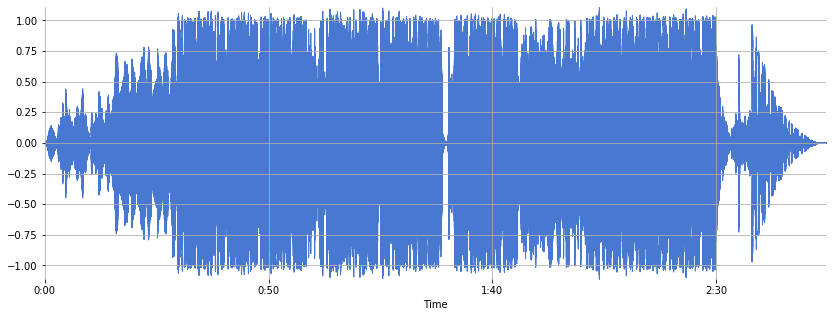

In [5]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr)

## `librosa.onset.onset_detect`

[`librosa.onset.onset_detect`](http://librosa.github.io/librosa/generated/librosa.onset.onset_detect.html#librosa.onset.onset_detect) works in the following way:

1.  Compute a spectral novelty function.
2.  Find peaks in the spectral novelty function.
3.  [optional] Backtrack from each peak to a preceding local minimum. Backtracking can be useful for finding segmentation points such that the onset occurs shortly after the beginning of the segment.

Compute the frame indices for estimated onsets in a signal:

In [6]:
onset_frames = librosa.onset.onset_detect(x, sr=sr, wait=1, pre_avg=1, post_avg=1, pre_max=1, post_max=1)
print(onset_frames) # frame numbers of estimated onsets

[ 196  356  444  583  832  922  992 1022 1081 1219 1240 1269 1275 1301
 1310 1319 1339 1350 1370 1399 1439 1469 1479 1489 1498 1509 1518 1529
 1558 1578 1618 1638 1657 1688 1697 1717 1724 1732 1737 1745 1757 1777
 1796 1816 1827 1847 1856 1876 1890 1916 1956 1975 2005 2035 2075 2105
 2115 2135 2145 2165 2195 2214 2224 2274 2293 2324 2333 2344 2353 2373
 2383 2423 2433 2453 2463 2483 2492 2512 2523 2534 2565 2592 2633 2642
 2670 2681 2691 2697 2711 2741 2751 2759 2761 2771 2781 2807 2811 2830
 2841 2850 2910 2930 2955 2960 2969 2978 2984 2989 2999 3009 3016 3022
 3029 3049 3059 3069 3089 3108 3119 3128 3143 3148 3188 3208 3218 3228
 3248 3268 3278 3288 3307 3318 3347 3386 3407 3417 3437 3450 3466 3486
 3506 3546 3566 3586 3596 3605 3616 3625 3655 3665 3668 3683 3695 3704
 3715 3725 3735 3745 3755 3765 3784 3882 3893 3902 3913 3981 4001 4031
 4060 4080 4100 4130 4140 4170 4190 4219 4229 4239 4299 4318 4349 4368
 4378 4398 4408 4448 4458 4478 4488 4508 4517 4537 4639 4650 4697 4711
 4717 

Convert onsets to units of seconds:

In [7]:
onset_times = librosa.frames_to_time(onset_frames)
print(onset_times)

[  4.55111111   8.26630385  10.30965986  13.53723356  19.31900227
  21.40879819  23.03419501  23.73079365  25.10077098  28.30512472
  28.79274376  29.46612245  29.60544218  30.209161    30.41814059
  30.62712018  31.09151927  31.34693878  31.81133787  32.48471655
  33.41351474  34.11011338  34.34231293  34.57451247  34.78349206
  35.03891156  35.24789116  35.50331066  36.17668934  36.64108844
  37.56988662  38.03428571  38.47546485  39.19528345  39.40426304
  39.86866213  40.03120181  40.21696145  40.33306122  40.51882086
  40.79746032  41.26185941  41.70303855  42.16743764  42.42285714
  42.88725624  43.09623583  43.56063492  43.88571429  44.48943311
  45.41823129  45.85941043  46.55600907  47.25260771  48.1814059
  48.87800454  49.11020408  49.57460317  49.80680272  50.27120181
  50.96780045  51.40897959  51.64117914  52.80217687  53.24335601
  53.9631746   54.1721542   54.4275737   54.63655329  55.10095238
  55.33315193  56.26195011  56.49414966  56.95854875  57.1907483
  57.6551473

Plot the onsets on top of a spectrogram of the audio:

In [8]:
S = librosa.stft(x)
logS = librosa.amplitude_to_db(abs(S))

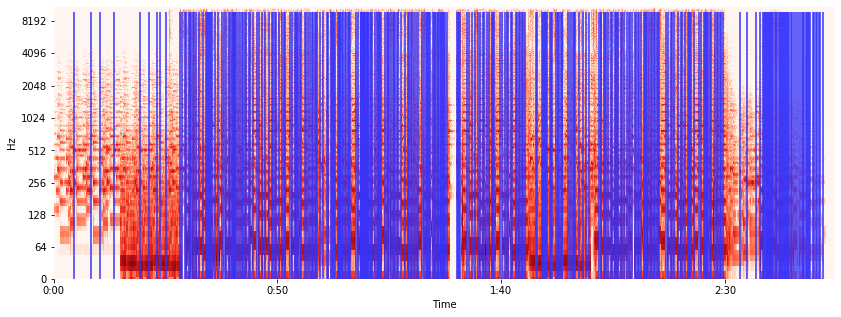

In [9]:
plt.figure(figsize=(14, 5))
librosa.display.specshow(logS, sr=sr, x_axis='time', y_axis='log', cmap='Reds')
plt.vlines(onset_times, 0, 10000, color='#3333FF')

Let's also plot the onsets with the time-domain waveform.

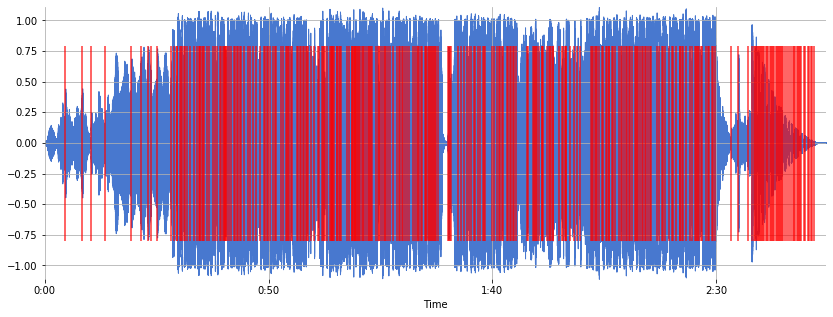

In [10]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)
plt.vlines(onset_times, -0.8, 0.79, color='r', alpha=0.8) 

## librosa.clicks

We can add a click at the location of each detected onset.

In [11]:
clicks = librosa.clicks(frames=onset_frames, sr=sr, length=len(x))

Listen to the original audio plus the detected onsets. One way is to add the signals together, sample-wise:

In [12]:
ipd.Audio(x + clicks, rate=sr)

Another method is to play the original track in one stereo channel and the click track in the other stereo channel:

In [13]:
ipd.Audio(numpy.vstack([x, clicks]), rate=sr)

You can also change the click to a custom audio file instead:

In [14]:
cowbell, _ = librosa.load('audio/cowbell.wav')

In [15]:
ipd.Audio(cowbell, rate=sr)

More cowbell?

In [16]:
clicks = librosa.clicks(frames=onset_frames, sr=sr, length=len(x), click=cowbell)

In [17]:
ipd.Audio(x + clicks, rate=sr)

In [18]:
ipd.Image(url='http://www.reactiongifs.com/r/2013/11/More-cowbell.gif')

## Questions

In `librosa.onset.onset_detect`, use the `backtrack=True` parameter. What does that do, and how does it affect the detected onsets? (See [`librosa.onset.onset_backtrack`](http://librosa.github.io/librosa/generated/librosa.onset.onset_backtrack.html#).)

In `librosa.onset.onset_detect`, you can use the keyword parameters found in [`librosa.util.peak_pick`](http://librosa.github.io/librosa/generated/librosa.util.peak_pick.html#librosa.util.peak_pick), e.g. `pre_max`, `post_max`, `pre_avg`, `post_avg`, `delta`, and `wait`, to control the peak picking algorithm. Adjust these parameters. How does it affect the detected onsets?

[&larr; Back to Index](index.html)